# **Fashion Style Generation: Evolutionary Search with Gaussian Mixture Models in the Latent Space** - Style Model

For the main algorithm, please take a look at the [main notebook](https://colab.research.google.com/drive/1rLI9bwRbu9H62Ca3fwSn9W0neuQ_X45M?usp=sharing).

This notebook presents the code for training the style model, 
consisting of a ResNet50 and a Gaussian Mixture Model (GMM).

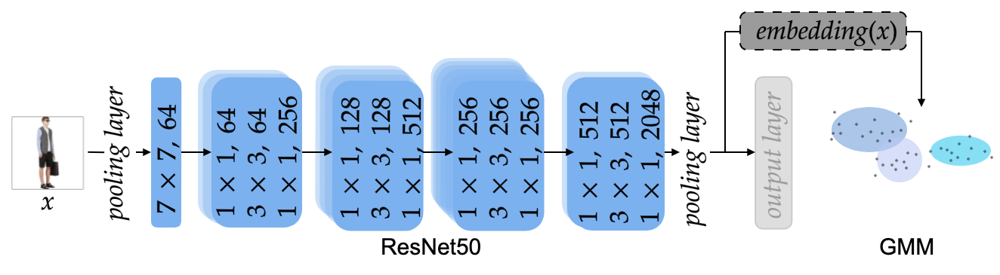

To identify styles in the [FashionGen dataset](https://fashion-gen.com/) (Rostamzadeh et al., 2018), we use the ResNet50 to extract the embedding for images in the dataset.
The GMM is used to find styles as Gaussian mixture components among the 
the embedding set.

To generate designs of a certain style later on, the embedding for generated images is used to estimate how well an image represents a style by projecting it onto the GMM's cluster space during the evolutionary search.

#**Set-up**
To run the code in Google Colab, download the content in this folder: https://drive.google.com/drive/folders/1TyMeCahYcZRf_VWxp8FSZrMTnE8BW2h_?usp=sharing
and save it in this path: **/content/drive/MyDrive/fashionstyle-generation-GMM/**
You might also want to download and save the FashionGen in a subfolder **/dataset**, however, that's not needed to try out the algortihm with our pre-trained models.

In [ ]:
import torch
import torch.nn as nn
import torch.hub as hub
import torchvision
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np
import matplotlib.pyplot as plt
import h5py
from sklearn.preprocessing import normalize
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import pickle
import random

In [ ]:
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0))
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

1
Tesla K80


device(type='cuda')

In [1]:
from google.colab import drive
drive.mount('/content/drive')
%cd /content/drive/MyDrive/fashionstyle-generation-GMM/

Mounted at /content/drive
/content/drive/MyDrive/fashionstyle-generation-GMM


In [2]:
%ls

FashionGen_s6_i96000.pt               master_model.ipynb     style_model.ipynb
gmm-nonorm-centonly-135pca-150kdiag/  resnet50_adjusted.pth
LICENCE                               resnet.pt


#**ResNet50**: From images to embedding 

We use the backbone of the attribute prediction model provided by the open-source toolbox for visual fashion analysis by the Multimedia Lab, Chinese University of Hong Kong: https://github.com/open-mmlab/mmfashion

Initialize ResNet50 model and create state dict for pre-trained model:

In [ ]:
#defining resnet50 model + state dict initialized randomly
model = models.resnet50(pretrained=False)
model.to(cuda0)
sd = model.state_dict()
print(len(sd))
for key, param in sd.items():
  print (key, param.shape)
#print(model._modules)

320
conv1.weight torch.Size([64, 3, 7, 7])
bn1.weight torch.Size([64])
bn1.bias torch.Size([64])
bn1.running_mean torch.Size([64])
bn1.running_var torch.Size([64])
bn1.num_batches_tracked torch.Size([])
layer1.0.conv1.weight torch.Size([64, 64, 1, 1])
layer1.0.bn1.weight torch.Size([64])
layer1.0.bn1.bias torch.Size([64])
layer1.0.bn1.running_mean torch.Size([64])
layer1.0.bn1.running_var torch.Size([64])
layer1.0.bn1.num_batches_tracked torch.Size([])
layer1.0.conv2.weight torch.Size([64, 64, 3, 3])
layer1.0.bn2.weight torch.Size([64])
layer1.0.bn2.bias torch.Size([64])
layer1.0.bn2.running_mean torch.Size([64])
layer1.0.bn2.running_var torch.Size([64])
layer1.0.bn2.num_batches_tracked torch.Size([])
layer1.0.conv3.weight torch.Size([256, 64, 1, 1])
layer1.0.bn3.weight torch.Size([256])
layer1.0.bn3.bias torch.Size([256])
layer1.0.bn3.running_mean torch.Size([256])
layer1.0.bn3.running_var torch.Size([256])
layer1.0.bn3.num_batches_tracked torch.Size([])
layer1.0.downsample.0.weight t

In [ ]:
#load pre-trained model from mmfashion: https://mmfashion.readthedocs.io/en/latest/MODEL_ZOO/ - pre-trained Attribute Prediction, Global Pooling 
#download: https://drive.google.com/open?id=1LmC4aKiOY3qmm9qo6RNDU5v_o-xDCAdT
file = torch.load(path+"/mmfashion_resnet50_model_global-pooling.pth")
file.keys()

dict_keys(['meta', 'state_dict', 'optimizer'])

In [ ]:
#pre-trained state_dict contains type-specific masks after the resnet18's pooling layer
pretrained_sd = file['state_dict']
len(pretrained_sd)
#for key, param in pretrained_sd.items():
#  print (key, param.shape)  

324

In [ ]:
#creating a state_dict with naming corresponding to model and the parameters from the pre-trained model:
#collecting the keys and params in one list each
new_keys = []
for key, params in sd.items():
  new_keys.append(key)
new_params = []
for key, params in pretrained_sd.items():
  new_params.append(params)

print(len(new_keys), len(new_params))

#combining the two lists to new state_dict
new_state_dict = {}
for n, i in enumerate(new_keys):
  new_state_dict[i] = new_params[n]

#replacing fc layer w/ original values as placeholder to fulfill resnet's shape requirements
#since we will extract feature vectors from the previous layer, this does not matter, bc the model's last fc layer is not used
new_state_dict['fc.weight'] = sd['fc.weight']
new_state_dict['fc.bias'] = sd['fc.bias']

#saving the new state dict
torch.save(new_state_dict, path+"/resnet50_adjusted.pth")

Load pretrained ResNet50 model (prepared in previous step) to create feature embedding

In [ ]:
model = models.resnet50(pretrained=False)
#model.to(cuda0)
#loading the new state_dict to the model - remember: last fc layer is just a placeholder, hence cannot be used
model.load_state_dict(torch.load("resnet50_adjusted.pth"))

<All keys matched successfully>

In [ ]:
model.eval()

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [ ]:
model._modules.keys()

odict_keys(['conv1', 'bn1', 'relu', 'maxpool', 'layer1', 'layer2', 'layer3', 'layer4', 'avgpool', 'fc'])

In [ ]:
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                 std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def extractembedding(image): #e.g. data[0]
  #convert image to tensor
  img = normalize(to_tensor(image).to(cuda0))
  img = img.unsqueeze(0)
  print(img.is_cuda)
  
  #choose layer
  layer = model._modules.layer1.get('downsample')

  #create empty feature vector
  feature_vector = torch.zeros(2048)

  #function that copies layer output into the feature vector
  def copy_data(module, input, output):
    print(output.shape)
    feature_vector.copy_(output.flatten())
  
  #adding copy function to the layer
  h = layer.register_forward_hook(copy_data)

  #do not update the weights
  with torch.no_grad():
    model(img)
  h.remove()

  return feature_vector

#datateaser = np.load("/content/drive/MyDrive/Speciale/0_Datasets/datateaser.npy")
#print(extractembedding(datateaser[0]))
#print(extractembedding(datateaser[1]))

Retrieve the embedding for all CLOTHING pose 4 images in the training set

In [ ]:
#read dataset
f = h5py.File('dataset/fashiongen_256_256_train.h5', 'r')
f.keys()

<KeysViewHDF5 ['index', 'index_2', 'input_brand', 'input_category', 'input_composition', 'input_concat_description', 'input_department', 'input_description', 'input_gender', 'input_image', 'input_msrpUSD', 'input_name', 'input_pose', 'input_productID', 'input_season', 'input_subcategory']>

In [ ]:
images = f['input_image']
departments = f['input_department']
poses = f['input_pose']
input_indices = f['index_2']

embedding = []
index_2 = []
counter = 0
for n, i in enumerate(images):
    if departments[n] == b'CLOTHING' and poses[n] == b'id_gridfs_4':
        embedding.append(extract2048features(i))
        index_2.append(input_indices[n])
        #print(n)
#print(len(embedding), len(index_2))

Exclude duplicates and save embedding and index

In [ ]:
new_embedding = [tuple(row) for row in embedding]
unique_embedding, unique_index = np.unique(new_embedding, return_index=True, axis=0)
embedding = unique_embedding
index_2 = index_2[unique_index]
#print(embedding.shape, index_2.shape)

# save embedding
with open('pose4-embedding-unique.pickle', 'wb') as handle:
  pickle.dump(embedding, handle)

with open('pose4-index2-unique.pickle', 'wb') as handle:
  pickle.dump(index_2, handle)

The embedding for all images of the subset, as well as the correspondix index for later visualization, are saved as **pose4-embedding-unique.pickle** and **pose4-embedding-unique.pickle** respectively.

#**GMM**: From embedding to style clusters

In [ ]:
# load embedding
handle = open('pose4-embedding-unique.pickle', 'rb')
embedding = pickle.load(handle)
handle.close()

handle = open('pose4-index2-unique.pickle', 'rb')
index_2 = pickle.load(handle)
handle.close()
index_2 = np.asarray(index_2)

#load images for plotting
f = h5py.File('dataset/fashiongen_256_256_train.h5', 'r')
images = f['input_image']

(47130, 2048)

In [ ]:
from sklearn.preprocessing import StandardScaler
centerer = StandardScaler(with_mean=True, with_std=False).fit(embedding)
cent_embedding = centerer.transform(embedding)

Apply PCA to embedding (135 principal components):

In [ ]:
#apply PCA to embedding
def apply_pca(embedding, p_com):
  pca = PCA(n_components=p_com)
  pca.fit(embedding)
  var_ratio = pca.explained_variance_ratio_
  cum_var_ratio = []
  for i in range(len(var_ratio)):
    cum_var_ratio.append(sum(var_ratio[:i+1]))
  print(cum_var_ratio)

  return pca.transform(cent_embedding), cum_var_ratio, pca

In [ ]:
pro_e, _, pca = apply_pca(cent_embedding, 135)

Use GMM to find styles (150 style clusters/components):

In [ ]:
from sklearn.mixture import GaussianMixture
gmm = GaussianMixture(150, covariance_type='diag').fit(pro_e)
labels = gmm.predict(pro_e)
probabilities = gmm.predict_proba(pro_e)

In [ ]:
def plotclusters(images, index_2, labels, distances, howto):
  n = 10 #number per label
  print(len(np.unique(labels)))
  plt.rcParams["figure.figsize"] = (30,3)
  for i in np.unique(labels):
    if howto == "closest":
      #choose closest n image indices to plot the images
      image_ind = index_2[np.argsort(distances[:,i])[:n]]
      #print(labels[np.argsort(distances[:,i])[:n]])
      image_ind = index_2[np.where(labels==i)[0][np.argsort(-1*distances[np.where(labels==i)[0], i])[:n]]]
      image_dist = -1*np.sort(-1*distances[np.where(labels==i)[0], i])[:n]
    
    elif howto == "random":
      #randomly choose n of them to plot
      image_ind = np.random.choice(np.where(labels==i)[0], size=n, replace=True) 

    #plot them in a grid
    plt.subplots(1,n)
    for j, ind in enumerate(image_ind):
      plt.subplot(1,n,j+1)
      plt.imshow(images[ind])
      ax = plt.gca()
      ax.axes.xaxis.set_ticks([])
      ax.axes.yaxis.set_ticks([])
      ax.set_xlabel((i, image_dist[j]))
      #ax.axis('off')
    #plt.savefig('/{}/clusterno{}.png'.format(len(np.unique(labels)), i))
      
  #pdf.savefig(fig)
  #pdf.close()

150


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


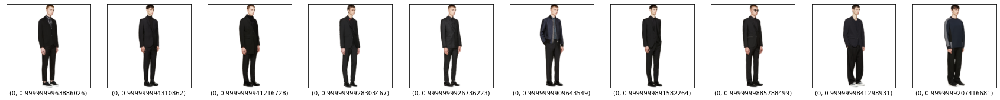

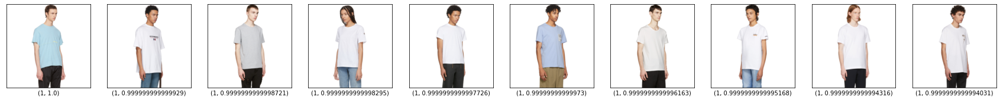

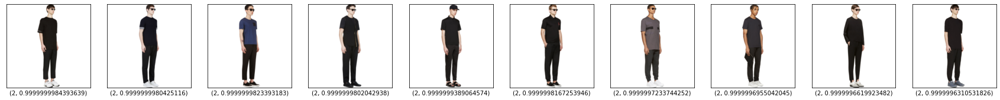

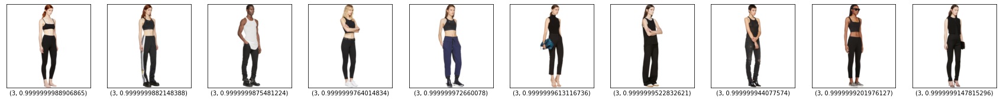

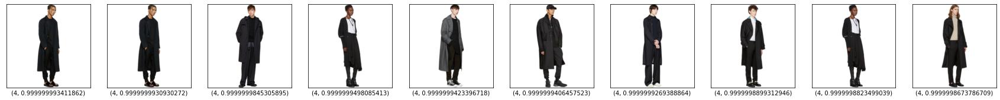

...

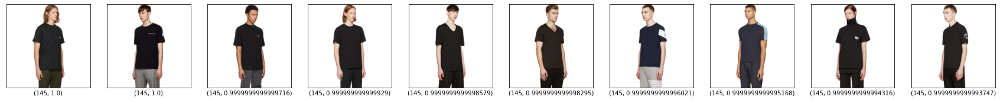

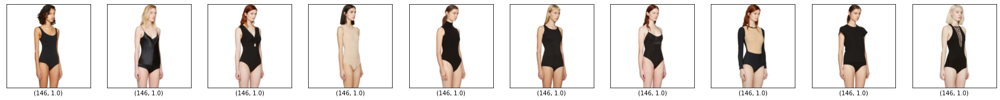

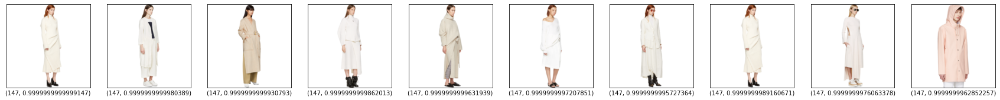

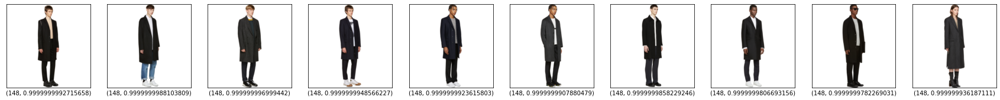

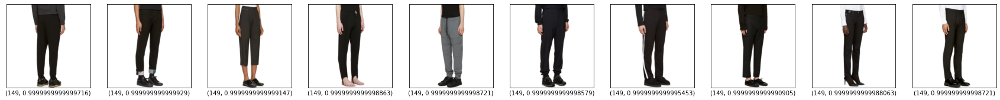

In [ ]:
plotclusters(images, index_2, labels, probabilities, "closest")

Save all the GMM parameters:

In [ ]:
#SAVING ALL MODELS AND PARAMS
instance = "gmm_cluster_matter/nonorm-centonly-135pca-150kdiag"

#centerer
with open('{}/scaler.pickle'.format(instance), 'wb') as handle:
  pickle.dump(centerer, handle)

#pca
with open('{}/pca.pickle'.format(instance), 'wb') as handle:
  pickle.dump(pca, handle)

#kmeans model
with open('{}/gmm.pickle'.format(instance), 'wb') as handle:
  pickle.dump(gmm, handle)

#labels
with open('{}/labels.pickle'.format(instance), 'wb') as handle:
  pickle.dump(labels, handle)

#distances for all images
with open('{}/probabilities.pickle'.format(instance), 'wb') as handle:
  pickle.dump(probabilities, handle)

#Clusters for experimentation

In [ ]:
a, b, c, d, e = 11, 48, 65, 98, 138
for i in (11, 48, 65, 98, 138):
  print(np.mean(probabilities[np.argwhere(labels==i),i]))

In [ ]:
c = probabilities[np.argwhere(labels==11),11]
d = probabilities[np.argwhere(labels==48),48]
e = probabilities[np.argwhere(labels==65),65]
a = probabilities[np.argwhere(labels==96),96]
b = probabilities[np.argwhere(labels==138),138]

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  return array(a, dtype, copy=False, order=order)


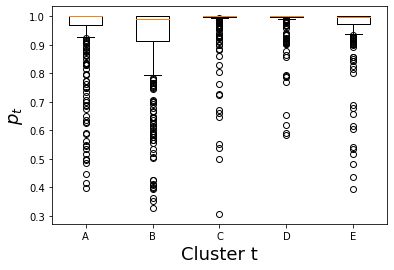

In [ ]:
data = [a,b,c,d,e]
plt.boxplot(data)
plt.xticks([1, 2, 3, 4, 5], ['A', 'B', 'C', 'D', 'E'])
plt.xlabel('Cluster t', fontsize=18)
plt.ylabel('$p_t$', fontsize=18)
plt.savefig('boxplot-cluster.png')
plt.show()

#**References**
Grabe, I.: Evolutionary Search for Fashion Styles in the Latent Space of Generative Adversarial Networks. Master’s thesis, University of Copenhagen (2021)

Rostamzadeh, N., Hosseini, S., Boquet, T., Stokowiec, W., Zhang, Y., Jauvin, C., Pal, C.: Fashion-Gen: The Generative Fashion Dataset and Challenge. arXiv preprint arXiv:1806.08317 (2018)



#**Citation**
--------
If you use our code for your research, please cite:
```bibtex
@inproceedings{grabe_fashion_2022,
	title = {Fashion {Style} {Generation}: {Evolutionary} {Search} with {Gaussian} {Mixture} {Models} in the {Latent} {Space}},
	booktitle = {International {Conference} on {Computational} {Intelligence} in {Music}, {Sound}, {Art} and {Design} : {EvoMUSART} 2022},
	author = {Grabe, Imke and Zhu, Jichen and Agirrezabal, Manex},
	year = {2022},
	pages = {16},
}
```

